In [38]:
import keras
import tensorflow as tf
import gdal
import os
import matplotlib.pyplot as plt
import numpy as np
from pathlib import Path
from keras_unet.models import custom_unet, satellite_unet
from keras_unet.metrics import iou, iou_thresholded
from keras_unet.losses import jaccard_distance
from keras_unet.utils import plot_segm_history

In [39]:
base_dir = Path(r'/media/studentuser/PATRIOT/training')
mask_dir = base_dir.joinpath('masks_img')
image_dir = base_dir.joinpath('img')
water_dir = mask_dir.joinpath('water_img')
shrubs_dir = mask_dir.joinpath('shrubs_img')
poly_dir = mask_dir.joinpath('polygonal_img')
trees_dir = mask_dir.joinpath('trees_img')
low_dir = mask_dir.joinpath('low_density_img')

In [40]:
def make_path(img_dir, prefix, number):
    return os.path.join(img_dir, f"{prefix}_{number}.tif")

In [41]:
def img_number(fpath: str) -> int:
    return int(os.path.splitext(os.path.split(fpath)[1])[0].split('_')[-1])

In [42]:
def load_image(path: str) -> np.ndarray:
    ds = gdal.Open(path, gdal.GA_ReadOnly)
    return ds.GetRasterBand(1).ReadAsArray()

In [43]:
def load_stack(shape, dtype, img_dir, prefix):
    stack = np.zeros(shape = shape, dtype = dtype)
    for i in range(shape[0]):
        image_path = make_path(img_dir, prefix, i + 1)
        stack[i, :, :] = load_image(image_path)
    return stack

def load_stack_safely(shape, dtype, img_dir, prefix):
    stack = np.zeros(shape = shape, dtype = dtype)
    for i in range(shape[0]):
        image_path = make_path(img_dir, prefix, i + 1)
        if not os.path.isfile(image_path):
            print("skipping", image_path)
            continue
        stack[i, :, :] = load_image(image_path)
    return stack

In [44]:
I = 200
N = 256
M = 256
train_images = load_stack((I, N, M), np.float32, image_dir, "img")

In [45]:
train_images_R = train_images.reshape(I, N, M, 1)

In [46]:
train_images_R.shape

(200, 256, 256, 1)

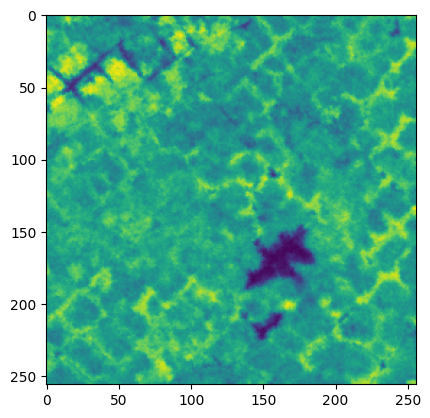

In [47]:
plt.imshow(train_images[1, :,:])

In [48]:
water_mask = load_stack_safely((I, N, M), np.int8, water_dir, "water")
poly_mask = load_stack_safely((I, N, M), np.int8, poly_dir, "polygonal")
trees_mask = load_stack_safely((I, N, M), np.int8, trees_dir, "tree")
shrubs_mask = load_stack_safely((I, N, M), np.int8, shrubs_dir, "shrub")
low_mask = load_stack_safely((I, N, M), np.int8, low_dir, "low")

skipping /media/studentuser/PATRIOT/training/masks_img/water_img/water_2.tif
skipping /media/studentuser/PATRIOT/training/masks_img/water_img/water_7.tif
skipping /media/studentuser/PATRIOT/training/masks_img/water_img/water_10.tif
skipping /media/studentuser/PATRIOT/training/masks_img/water_img/water_13.tif
skipping /media/studentuser/PATRIOT/training/masks_img/water_img/water_15.tif
skipping /media/studentuser/PATRIOT/training/masks_img/water_img/water_22.tif
skipping /media/studentuser/PATRIOT/training/masks_img/water_img/water_23.tif
skipping /media/studentuser/PATRIOT/training/masks_img/water_img/water_24.tif
skipping /media/studentuser/PATRIOT/training/masks_img/water_img/water_35.tif
skipping /media/studentuser/PATRIOT/training/masks_img/water_img/water_36.tif
skipping /media/studentuser/PATRIOT/training/masks_img/water_img/water_38.tif
skipping /media/studentuser/PATRIOT/training/masks_img/water_img/water_40.tif
skipping /media/studentuser/PATRIOT/training/masks_img/water_img/w

skipping /media/studentuser/PATRIOT/training/masks_img/shrubs_img/shrub_87.tif
skipping /media/studentuser/PATRIOT/training/masks_img/shrubs_img/shrub_89.tif
skipping /media/studentuser/PATRIOT/training/masks_img/shrubs_img/shrub_91.tif
skipping /media/studentuser/PATRIOT/training/masks_img/shrubs_img/shrub_92.tif
skipping /media/studentuser/PATRIOT/training/masks_img/shrubs_img/shrub_96.tif
skipping /media/studentuser/PATRIOT/training/masks_img/shrubs_img/shrub_98.tif
skipping /media/studentuser/PATRIOT/training/masks_img/shrubs_img/shrub_101.tif
skipping /media/studentuser/PATRIOT/training/masks_img/shrubs_img/shrub_102.tif
skipping /media/studentuser/PATRIOT/training/masks_img/shrubs_img/shrub_103.tif
skipping /media/studentuser/PATRIOT/training/masks_img/shrubs_img/shrub_105.tif
skipping /media/studentuser/PATRIOT/training/masks_img/shrubs_img/shrub_109.tif
skipping /media/studentuser/PATRIOT/training/masks_img/shrubs_img/shrub_115.tif
skipping /media/studentuser/PATRIOT/training/m

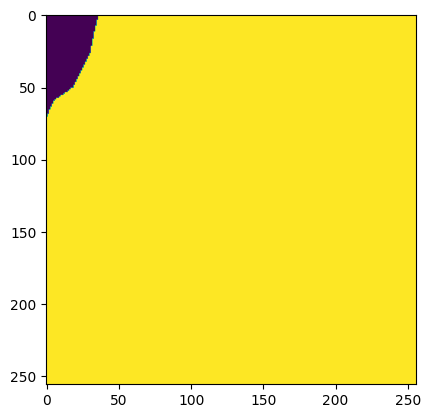

In [49]:
plt.imshow(low_mask[165, :,:])

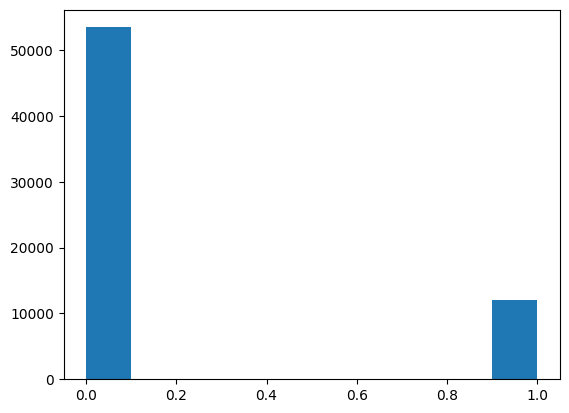

In [50]:
plt.hist(poly_mask[0, :,:].flatten())
plt.show()

In [51]:
model = satellite_unet((N, M, 1), 5)

In [52]:
model.compile(
    optimizer = tf.keras.optimizers.Adam(),
    loss = "binary_crossentropy",
    metrics = [iou, iou_thresholded],
)

In [53]:
# Image 13 held out due to low image quality from smoke

W = 159
Y = np.zeros(shape=(W, N, M, 5), dtype =np.int8)
Y_train_img = np.zeros(shape=(W, N, M, 1), dtype =np.float32)

Y[0:12, :, :, 0] = trees_mask[0:12, :, :]
Y[0:12, :, :, 1] = poly_mask[0:12, :, :]
Y[0:12, :, :, 2] = water_mask[0:12, :, :]
Y[0:12, :, :, 3] = shrubs_mask[0:12, :, :]
Y[0:12, :, :, 4] = low_mask[0:12, :, :]
Y_train_img[0:12, :, :, 0] = train_images_R[0:12, :, :, 0]

Y[12:W, :, :, 0] = trees_mask[13:W+1, :, :]
Y[12:W, :, :, 1] = poly_mask[13:W+1, :, :]
Y[12:W, :, :, 2] = water_mask[13:W+1, :, :]
Y[12:W, :, :, 3] = shrubs_mask[13:W+1, :, :]
Y[12:W, :, :, 4] = low_mask[13:W+1, :, :]
Y_train_img[12:W, :, :, 0] = train_images_R[13:W+1, :, :, 0]

In [54]:
# Image 175 held out due to low image quality from smoke

K = 39
Y_valid = np.zeros(shape=(K, N, M, 5), dtype =np.int8)
Y_valid_img = np.zeros(shape=(K, N, M, 1), dtype =np.float32)

Y_valid[0:14, :, :, 0] = trees_mask[160:174, :, :]
Y_valid[0:14, :, :, 1] = poly_mask[160:174, :, :]
Y_valid[0:14, :, :, 2] = water_mask[160:174, :, :]
Y_valid[0:14, :, :, 3] = shrubs_mask[160:174, :, :]
Y_valid[0:14, :, :, 4] = low_mask[160:174, :, :]
Y_valid_img[0:14, :, :, 0] = train_images_R[160:174, :, :, 0]

Y_valid[14:K, :, :, 0] = trees_mask[175:200, :, :]
Y_valid[14:K, :, :, 1] = poly_mask[175:200, :, :]
Y_valid[14:K, :, :, 2] = water_mask[175:200, :, :]
Y_valid[14:K, :, :, 3] = shrubs_mask[175:200, :, :]
Y_valid[14:K, :, :, 4] = low_mask[175:200, :, :]
Y_valid_img[14:K, :, :, 0] = train_images_R[175:200, :, :, 0]

In [55]:
low_mask[46, :,:]

array([[1, 1, 1, ..., 1, 1, 1],
       [1, 1, 1, ..., 1, 1, 1],
       [1, 1, 1, ..., 1, 1, 1],
       ...,
       [1, 1, 1, ..., 1, 1, 1],
       [1, 1, 1, ..., 1, 1, 1],
       [1, 1, 1, ..., 1, 1, 1]], dtype=int8)

In [56]:
Y[45,:,:,4]

array([[1, 1, 1, ..., 1, 1, 1],
       [1, 1, 1, ..., 1, 1, 1],
       [1, 1, 1, ..., 1, 1, 1],
       ...,
       [1, 1, 1, ..., 1, 1, 1],
       [1, 1, 1, ..., 1, 1, 1],
       [1, 1, 1, ..., 1, 1, 1]], dtype=int8)

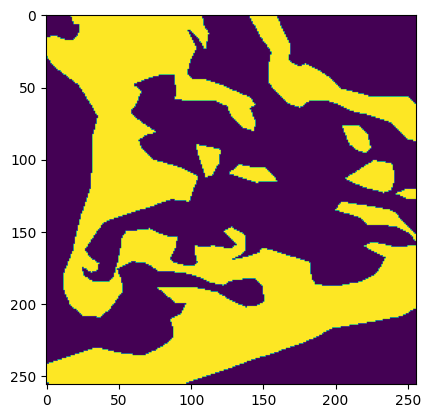

In [57]:
plt.imshow(Y[10,:,:,4])

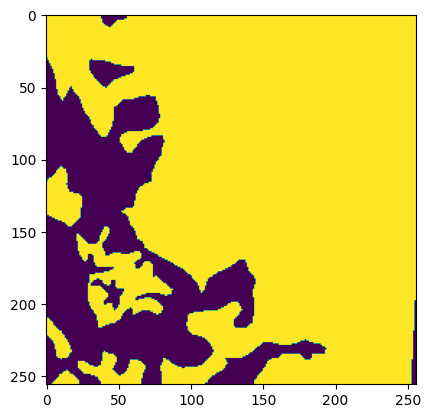

In [58]:
plt.imshow(water_mask[11,:, :])

In [59]:
Y_valid_img.shape

(39, 256, 256, 1)

In [60]:
Y.shape

(159, 256, 256, 5)

In [67]:
history = model.fit(Y_train_img, Y, epochs = 200)

Epoch 1/200
5/5 [==============================] - 27s 4s/step - loss: 0.5895 - iou: 0.1423 - iou_thresholded: 0.1632
Epoch 2/200
5/5 [==============================] - 21s 4s/step - loss: 0.3257 - iou: 0.2049 - iou_thresholded: 0.2630
Epoch 3/200
5/5 [==============================] - 20s 4s/step - loss: 0.2918 - iou: 0.2283 - iou_thresholded: 0.2262
Epoch 4/200
5/5 [==============================] - 21s 4s/step - loss: 0.2882 - iou: 0.2417 - iou_thresholded: 0.2768
Epoch 5/200
5/5 [==============================] - 20s 4s/step - loss: 0.2602 - iou: 0.2717 - iou_thresholded: 0.3288
Epoch 6/200
5/5 [==============================] - 21s 4s/step - loss: 0.2438 - iou: 0.2941 - iou_thresholded: 0.3741
Epoch 7/200
5/5 [==============================] - 21s 4s/step - loss: 0.2548 - iou: 0.2923 - iou_thresholded: 0.3499
Epoch 8/200
5/5 [==============================] - 20s 4s/step - loss: 0.2506 - iou: 0.2807 - iou_thresholded: 0.3134
Epoch 9/200
5/5 [==============================] - 20s 4

5/5 [==============================] - 20s 4s/step - loss: 0.1665 - iou: 0.4463 - iou_thresholded: 0.5657
Epoch 70/200
5/5 [==============================] - 20s 4s/step - loss: 0.1784 - iou: 0.4244 - iou_thresholded: 0.5270
Epoch 71/200
5/5 [==============================] - 21s 4s/step - loss: 0.1580 - iou: 0.4534 - iou_thresholded: 0.5587
Epoch 72/200
5/5 [==============================] - 20s 4s/step - loss: 0.1618 - iou: 0.4685 - iou_thresholded: 0.5888
Epoch 73/200
5/5 [==============================] - 21s 4s/step - loss: 0.1742 - iou: 0.4620 - iou_thresholded: 0.5638
Epoch 74/200
5/5 [==============================] - 20s 4s/step - loss: 0.1578 - iou: 0.4721 - iou_thresholded: 0.5687
Epoch 75/200
5/5 [==============================] - 20s 4s/step - loss: 0.1635 - iou: 0.4640 - iou_thresholded: 0.5499
Epoch 76/200
5/5 [==============================] - 21s 4s/step - loss: 0.1607 - iou: 0.4658 - iou_thresholded: 0.5661
Epoch 77/200
5/5 [==============================] - 20s 4s/st

5/5 [==============================] - 20s 4s/step - loss: 0.0918 - iou: 0.6612 - iou_thresholded: 0.7550
Epoch 138/200
5/5 [==============================] - 20s 4s/step - loss: 0.0850 - iou: 0.6762 - iou_thresholded: 0.7680
Epoch 139/200
5/5 [==============================] - 21s 4s/step - loss: 0.0890 - iou: 0.6740 - iou_thresholded: 0.7593
Epoch 140/200
5/5 [==============================] - 20s 4s/step - loss: 0.0924 - iou: 0.6702 - iou_thresholded: 0.7531
Epoch 141/200
5/5 [==============================] - 20s 4s/step - loss: 0.0894 - iou: 0.6854 - iou_thresholded: 0.7662
Epoch 142/200
5/5 [==============================] - 20s 4s/step - loss: 0.0807 - iou: 0.6938 - iou_thresholded: 0.7824
Epoch 143/200
5/5 [==============================] - 20s 4s/step - loss: 0.0874 - iou: 0.6850 - iou_thresholded: 0.7710
Epoch 144/200
5/5 [==============================] - 20s 4s/step - loss: 0.0899 - iou: 0.6798 - iou_thresholded: 0.7663
Epoch 145/200
5/5 [==============================] - 2

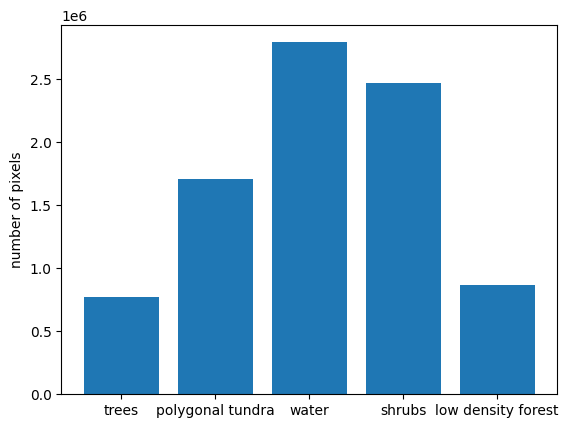

In [68]:
fig, ax = plt.subplots()
ax.bar(range(5), [trees_mask.sum(), poly_mask.sum(), water_mask.sum(), shrubs_mask.sum(), low_mask.sum()])
ax.set_xticks((0, 1, 2, 3, 4))
ax.set_xticklabels(('trees', 'polygonal tundra', 'water', 'shrubs', 'low density forest'))
plt.ylabel('number of pixels')
plt.show()

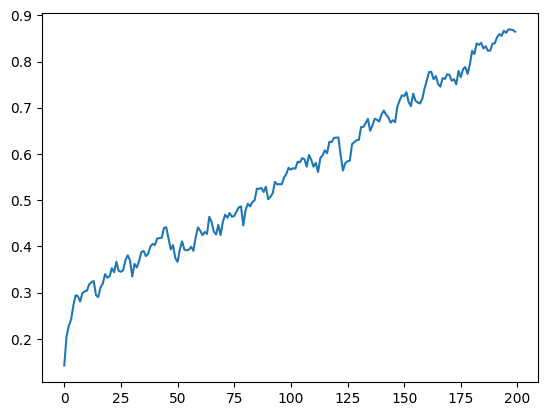

In [69]:
plt.plot(history.history['iou'])

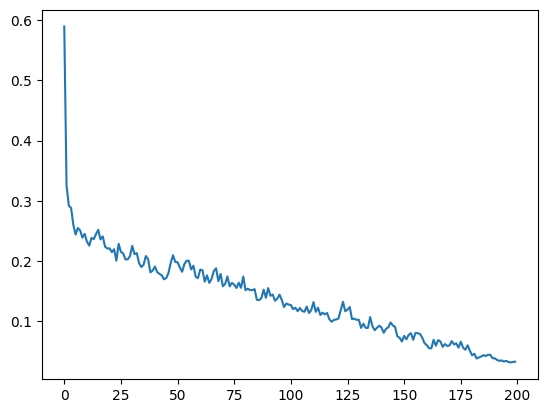

In [70]:
plt.plot(history.history['loss'])

In [71]:
Y_pred = model.predict(Y_train_img)

5/5 [==============================] - 8s 2s/step


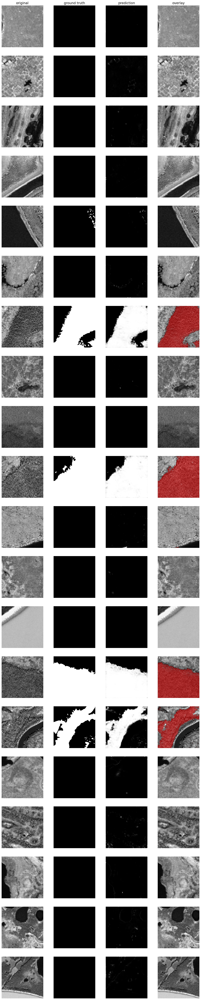

In [72]:
from keras_unet.utils import plot_imgs

# Trees
plot_imgs(
    org_imgs=Y_train_img, 
    mask_imgs=Y[:, :, :, 0], 
    pred_imgs=Y_pred[:, :, :, 0], 
    nm_img_to_plot=20
  )

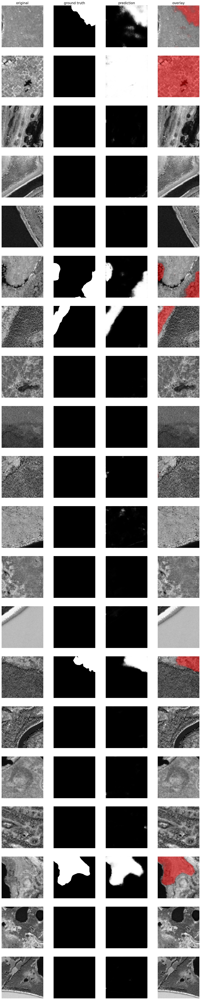

In [73]:
# Polygonal Tundra
plot_imgs(
    org_imgs=Y_train_img, 
    mask_imgs=Y[:, :, :, 1], 
    pred_imgs=Y_pred[:, :, :, 1], 
    nm_img_to_plot=20
  )

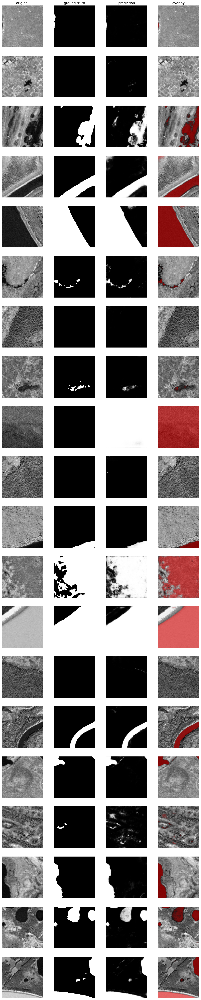

In [74]:
# Water
plot_imgs(
    org_imgs=Y_train_img, 
    mask_imgs=Y[:, :, :, 2], 
    pred_imgs=Y_pred[:, :, :, 2], 
    nm_img_to_plot=20
  )

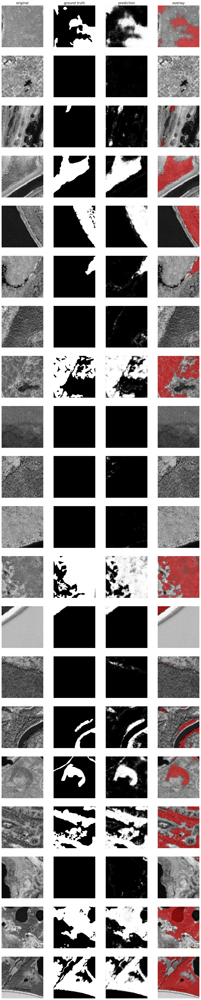

In [75]:
# Shrubs
plot_imgs(
    org_imgs=Y_train_img, 
    mask_imgs=Y[:, :, :, 3], 
    pred_imgs=Y_pred[:, :, :, 3], 
    nm_img_to_plot=20
  )

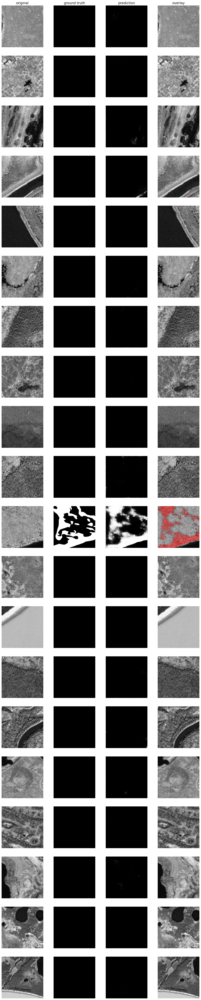

In [76]:
# Low density forest
plot_imgs(
    org_imgs=Y_train_img, 
    mask_imgs=Y[:, :, :, 4], 
    pred_imgs=Y_pred[:, :, :, 4], 
    nm_img_to_plot=20
  )

In [77]:
valid_pred = model.predict(Y_valid_img)

2/2 [==============================] - 2s 408ms/step


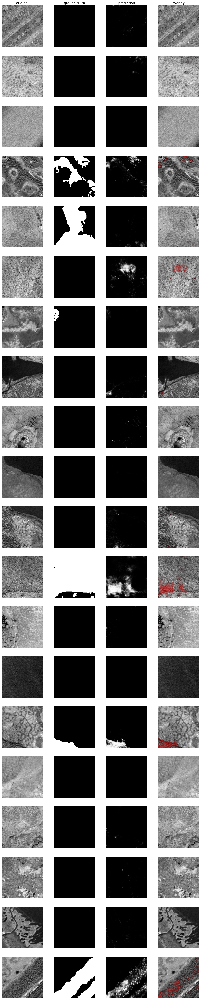

In [78]:
# Trees
plot_imgs(
    org_imgs=Y_valid_img, 
    mask_imgs=Y_valid[:, :, :, 0], 
    pred_imgs=valid_pred[:, :, :, 0], 
    nm_img_to_plot=20
  )

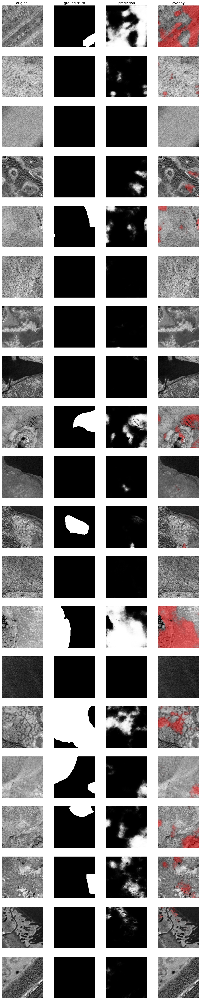

In [79]:
# Polygonal Tundra
plot_imgs(
    org_imgs=Y_valid_img, 
    mask_imgs=Y_valid[:, :, :, 1], 
    pred_imgs=valid_pred[:, :, :, 1], 
    nm_img_to_plot=20
  )

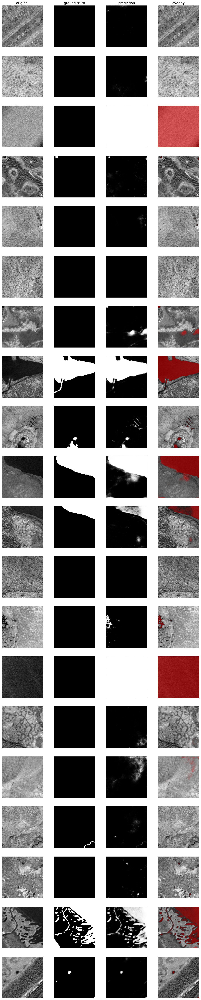

In [80]:
# Water
plot_imgs(
    org_imgs=Y_valid_img, 
    mask_imgs=Y_valid[:, :, :, 2], 
    pred_imgs=valid_pred[:, :, :, 2], 
    nm_img_to_plot=20
  )

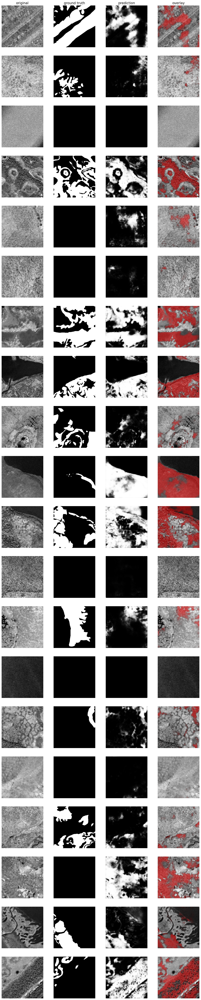

In [81]:
# Shrubs
plot_imgs(
    org_imgs=Y_valid_img, 
    mask_imgs=Y_valid[:, :, :, 3], 
    pred_imgs=valid_pred[:, :, :, 3], 
    nm_img_to_plot=20
  )

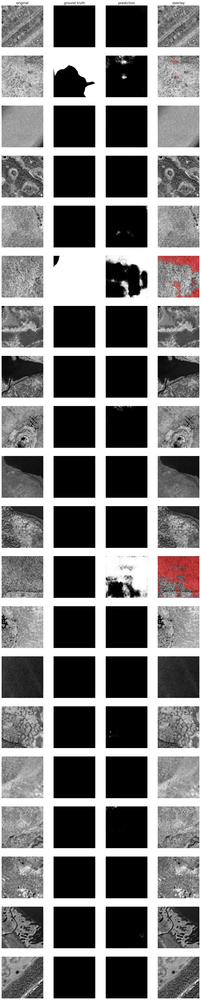

In [82]:
# Low density forest
plot_imgs(
    org_imgs=Y_valid_img, 
    mask_imgs=Y_valid[:, :, :, 4], 
    pred_imgs=valid_pred[:, :, :, 4], 
    nm_img_to_plot=20
  )